# Definitions

import libraries and set file/sheet names for parsing

In [1]:
import pandas
import openpyxl
from tqdm import tqdm

FILENAME = 'excel-files/ukbusinessworkbook2021.xlsx'
SAMPLE_SHEET = 'Table 1'

In [2]:
pandas.set_option("display.max_rows", None)

# Openpyxl

load the excel file using openpyxl and inspect sheets

In [3]:
wb = openpyxl.load_workbook(FILENAME)

In [4]:
wb.sheetnames[:5]

['Notes', 'Contents', 'Table 1', 'Table 2', 'Table 3']

In [5]:
sheet = wb[SAMPLE_SHEET]
sheet

<Worksheet "Table 1">

# Header

In [6]:
from openpyxl.worksheet.worksheet import Worksheet

The table title is contained somewhere on the top row, but the cell will depend on how many columns are used for indexing

loop through top row and return 0-indexed value for first cell that has values in it

In [7]:
class SearchException(Exception):
    pass
def get_header_col(ws: Worksheet, stop_search: int = 10000) -> int:
    i = 0
    while sheet.cell(1, i+1).value is None: # cell() is indexed from 1
        i += 1
        if stop_search and i > stop_search:
            raise SearchException
    return i

In [8]:
get_header_col(sheet)

2

# Info

Want a generic function that gets information from a spreadsheet extracting its title at the top and rows/columns used for data

In [9]:
from typing import TypedDict, List

In [10]:
class SheetInfo(TypedDict):
    title: str
    subtitle: str
    title_rows: List[int]
    index_cols: List[int]

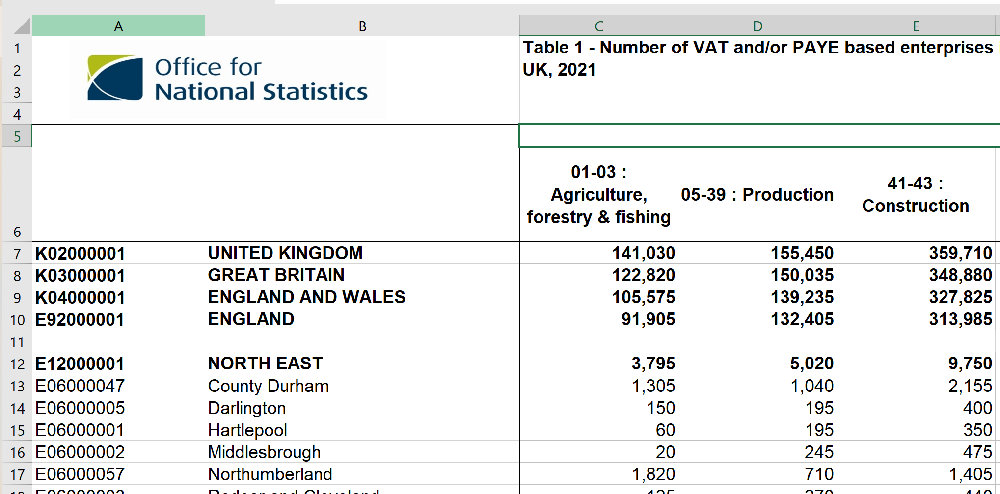

In [11]:
def get_sheet_info(ws: Worksheet) -> SheetInfo:
    header_col = get_header_col(ws)
    return {
        'title': ws.cell(1, header_col+1).value,
        'subtitle': ws.cell(2, header_col+1).value,
        'title_rows': [4, 5],
        'index_cols': list(range(header_col))
    }

In [12]:
sheet_info = get_sheet_info(sheet)
sheet_info

{'title': 'Table 1 - Number of VAT and/or PAYE based enterprises in districts, counties and unitary authorities within region and country by broad industry group',
 'subtitle': 'UK, 2021',
 'title_rows': [4, 5],
 'index_cols': [0, 1]}

# Sheet Data

Now can use pandas to gather sheets data

In [13]:
df = pandas.read_excel(
    FILENAME,
    sheet_name=SAMPLE_SHEET,
    header=sheet_info['title_rows'],
    index_col=sheet_info['index_cols']
)

In [14]:
df.head(20)

Broad Industry Group  \
                                     01-03 : Agriculture, forestry & fishing   
K02000001 UNITED KINGDOM                                            141030.0   
K03000001 GREAT BRITAIN                                             122820.0   
K04000001 ENGLAND AND WALES                                         105575.0   
E92000001 ENGLAND                                                    91905.0   
          ENGLAND                                                        NaN   
E12000001 NORTH EAST                                                  3795.0   
E06000047 County Durham                                               1305.0   
E06000005 Darlington                                                   150.0   
E06000001 Hartlepool                                                    60.0   
E06000002 Middlesbrough                                                 20.0   
E06000057 Northumberland                                              1820.0   
E06000003 Redcar and Cleveland                                         125.0   
E06000004 Stockton-on-Tees                                              90.0   
E11000007 Tyne and Wear (Met County)                                   225.0   
E08000037 Gateshead                                                     50.0   
E08000021 Newcastle upon Tyne                                           45.0   
E08000022 North Tyneside                                                45.0   
E08000023 South Tyneside                                                25.0   
E08000024 Sunderland                                                    60.0   
          Sunderland                                                     NaN   

                                                                              \
                                     05-39 : Production 41-43 : Construction   
K02000001 UNITED KINGDOM                       155450.0             359710.0   
K03000001 GREAT BRITAIN                        150035.0             348880.0   
K04000001 ENGLAND AND WALES                    139235.0             327825.0   
E92000001 ENGLAND                              132405.0             313985.0   
          ENGLAND                                   NaN                  NaN   
E12000001 NORTH EAST                             5020.0               9750.0   
E06000047 County Durham                          1040.0               2155.0   
E06000005 Darlington                              195.0                400.0   
E06000001 Hartlepool                              195.0                350.0   
E06000002 Middlesbrough                           245.0                475.0   
E06000057 Northumberland                          710.0               1405.0   
E06000003 Redcar and Cleveland                    270.0                440.0   
E06000004 Stockton-on-Tees                        385.0                790.0   
E11000007 Tyne and Wear (Met County)             1980.0               3735.0   
E08000037 Gateshead                               415.0                745.0   
E08000021 Newcastle upon Tyne                     400.0                840.0   
E08000022 North Tyneside                          395.0                735.0   
E08000023 South Tyneside                          285.0                540.0   
E08000024 Sunderland                              485.0                875.0   
          Sunderland                                NaN                  NaN   

                                                                       \
                                     45 : Motor trades 46 : Wholesale   
K02000001 UNITED KINGDOM                       78995.0       106740.0   
K03000001 GREAT BRITAIN                        76245.0       103555.0   
K04000001 ENGLAND AND WALES                    71465.0        98330.0   
E92000001 ENGLAND                              67675.0        95105.0   
          ENGLAND                                  NaN            NaN   
E12000001 NORTH EAST   

Now get rid of invalid rows with `nan`

In [15]:
df2 = df.dropna()

In [16]:
df2.head(20)

Broad Industry Group  \
                                     01-03 : Agriculture, forestry & fishing   
K02000001 UNITED KINGDOM                                            141030.0   
K03000001 GREAT BRITAIN                                             122820.0   
K04000001 ENGLAND AND WALES                                         105575.0   
E92000001 ENGLAND                                                    91905.0   
E12000001 NORTH EAST                                                  3795.0   
E06000047 County Durham                                               1305.0   
E06000005 Darlington                                                   150.0   
E06000001 Hartlepool                                                    60.0   
E06000002 Middlesbrough                                                 20.0   
E06000057 Northumberland                                              1820.0   
E06000003 Redcar and Cleveland                                         125.0   
E06000004 Stockton-on-Tees                                              90.0   
E11000007 Tyne and Wear (Met County)                                   225.0   
E08000037 Gateshead                                                     50.0   
E08000021 Newcastle upon Tyne                                           45.0   
E08000022 North Tyneside                                                45.0   
E08000023 South Tyneside                                                25.0   
E08000024 Sunderland                                                    60.0   
E12000002 NORTH WEST                                                 10870.0   
E06000008 Blackburn with Darwen                                         75.0   

                                                                              \
                                     05-39 : Production 41-43 : Construction   
K02000001 UNITED KINGDOM                       155450.0             359710.0   
K03000001 GREAT BRITAIN                        150035.0             348880.0   
K04000001 ENGLAND AND WALES                    139235.0             327825.0   
E92000001 ENGLAND                              132405.0             313985.0   
E12000001 NORTH EAST                             5020.0               9750.0   
E06000047 County Durham                          1040.0               2155.0   
E06000005 Darlington                              195.0                400.0   
E06000001 Hartlepool                              195.0                350.0   
E06000002 Middlesbrough                           245.0                475.0   
E06000057 Northumberland                          710.0               1405.0   
E06000003 Redcar and Cleveland                    270.0                440.0   
E06000004 Stockton-on-Tees                        385.0                790.0   
E11000007 Tyne and Wear (Met County)             1980.0               3735.0   
E08000037 Gateshead                               415.0                745.0   
E08000021 Newcastle upon Tyne                     400.0                840.0   
E08000022 North Tyneside                          395.0                735.0   
E08000023 South Tyneside                          285.0                540.0   
E08000024 Sunderland                              485.0                875.0   
E12000002 NORTH WEST                            16510.0              32365.0   
E06000008 Blackburn with Darwen                   485.0                460.0   

                                                                       \
                                     45 : Motor trades 46 : Wholesale   
K02000001 UNITED KINGDOM                       78995.0       106740.0   
K03000001 GREAT BRITAIN                        76245.0       103555.0   
K04000001 ENGLAND AND WALES                    71465.0        98330.0   
E92000001 ENGLAND                              67675.0        95105.0   
E12000001 NORTH EAST                            2495.0         2230.0   
E06000047 County Durham

Now, filter out column titles if any contain "Total" (column headers are multi-level)

In [17]:
df3 = df2[[x for x in df2.columns if not any(t=='Total' for t in x)]]
df3.head(20)

Broad Industry Group  \
                                     01-03 : Agriculture, forestry & fishing   
K02000001 UNITED KINGDOM                                            141030.0   
K03000001 GREAT BRITAIN                                             122820.0   
K04000001 ENGLAND AND WALES                                         105575.0   
E92000001 ENGLAND                                                    91905.0   
E12000001 NORTH EAST                                                  3795.0   
E06000047 County Durham                                               1305.0   
E06000005 Darlington                                                   150.0   
E06000001 Hartlepool                                                    60.0   
E06000002 Middlesbrough                                                 20.0   
E06000057 Northumberland                                              1820.0   
E06000003 Redcar and Cleveland                                         125.0   
E06000004 Stockton-on-Tees                                              90.0   
E11000007 Tyne and Wear (Met County)                                   225.0   
E08000037 Gateshead                                                     50.0   
E08000021 Newcastle upon Tyne                                           45.0   
E08000022 North Tyneside                                                45.0   
E08000023 South Tyneside                                                25.0   
E08000024 Sunderland                                                    60.0   
E12000002 NORTH WEST                                                 10870.0   
E06000008 Blackburn with Darwen                                         75.0   

                                                                              \
                                     05-39 : Production 41-43 : Construction   
K02000001 UNITED KINGDOM                       155450.0             359710.0   
K03000001 GREAT BRITAIN                        150035.0             348880.0   
K04000001 ENGLAND AND WALES                    139235.0             327825.0   
E92000001 ENGLAND                              132405.0             313985.0   
E12000001 NORTH EAST                             5020.0               9750.0   
E06000047 County Durham                          1040.0               2155.0   
E06000005 Darlington                              195.0                400.0   
E06000001 Hartlepool                              195.0                350.0   
E06000002 Middlesbrough                           245.0                475.0   
E06000057 Northumberland                          710.0               1405.0   
E06000003 Redcar and Cleveland                    270.0                440.0   
E06000004 Stockton-on-Tees                        385.0                790.0   
E11000007 Tyne and Wear (Met County)             1980.0               3735.0   
E08000037 Gateshead                               415.0                745.0   
E08000021 Newcastle upon Tyne                     400.0                840.0   
E08000022 North Tyneside                          395.0                735.0   
E08000023 South Tyneside                          285.0                540.0   
E08000024 Sunderland                              485.0                875.0   
E12000002 NORTH WEST                            16510.0              32365.0   
E06000008 Blackburn with Darwen                   485.0                460.0   

                                                                       \
                                     45 : Motor trades 46 : Wholesale   
K02000001 UNITED KINGDOM                       78995.0       106740.0   
K03000001 GREAT BRITAIN                        76245.0       103555.0   
K04000001 ENGLAND AND WALES                    71465.0        98330.0   
E92000001 ENGLAND                              67675.0        95105.0   
E12000001 NORTH EAST                            2495.0         2230.0   
E06000047 County Durham

# Regional Codes

The regional codes as the first index are all mixed in together - "districts, counties and unitary authorities within region and country"

The following below maps disctricts to regions - link used to download CSV is [here](https://geoportal.statistics.gov.uk/datasets/ons::local-authority-district-to-region-april-2021-lookup-in-england/about)

In [18]:
df_lookup = pandas.read_csv(r"excel-files/Local_Authority_District_to_Region_(April_2021)_Lookup_in_England.csv")

In [19]:
df_lookup.head(20)

,FID,LAD21CD,LAD21NM,RGN21CD,RGN21NM
0,1,E06000001,Hartlepool,E12000001,North East
1,2,E06000011,East Riding of Yorkshire,E12000003,Yorkshire and The Humber
2,3,E06000002,Middlesbrough,E12000001,North East
3,4,E06000003,Redcar and Cleveland,E12000001,North East
4,5,E06000012,North East Lincolnshire,E12000003,Yorkshire and The Humber
5,6,E06000013,North Lincolnshire,E12000003,Yorkshire and The Humber
6,7,E06000004,Stockton-on-Tees,E12000001,North East
7,8,E06000005,Darlington,E12000001,North East
8,9,E06000014,York,E12000003,Yorkshire and The Humber
9,10,E07000163,Craven,E12000003,Yorkshire and The Humber


Can see below that it is mapping "E06" through "E09" codes to "E12" codes

In [20]:
df_lookup['LAD21CD'].apply(lambda x: x[:3]).unique()

array(['E06', 'E07', 'E08', 'E09'], dtype=object)

In [21]:
df_lookup['RGN21CD'].apply(lambda x: x[:3]).unique()

array(['E12'], dtype=object)

However, **this is too broad**, the excel files goes one level deeper in that there are regions -> counties -> disctricts

Can see [from the file here](https://geoportal.statistics.gov.uk/datasets/ons::local-authority-district-to-county-april-2021-lookup-in-england/about) to map districts to counties 

In [22]:
df_lookup2 = pandas.read_csv("excel-files/Local_Authority_District_to_County_(April_2021)_Lookup_in_England.csv")

In [23]:
df_lookup2.head()

,FID,LAD21CD,LAD21NM,CTY21CD,CTY21NM
0,1,E07000008,Cambridge,E10000003,Cambridgeshire
1,2,E07000009,East Cambridgeshire,E10000003,Cambridgeshire
2,3,E07000134,North West Leicestershire,E10000018,Leicestershire
3,4,E07000010,Fenland,E10000003,Cambridgeshire
4,5,E07000135,Oadby and Wigston,E10000018,Leicestershire


In [24]:
df_lookup2['LAD21CD'].apply(lambda x: x[:3]).unique()

array(['E07', 'E08', 'E09'], dtype=object)

Note that normally, there is a region (E12), then a county (E10), then a district (E06/E07/E08/E09) 

- in the case below, the districts e.g. (E06000011) map **directly** to the region (E12)

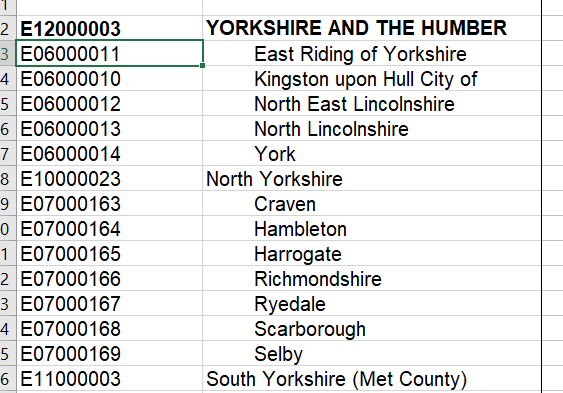

# ONS API

So it turns out the office for national statistics (ONS) have an API you can query

The ONS have a live query editor here: http://statistics.data.gov.uk/sparql

ONS use something called *sparql*, a SQL-like language for querying RDF graphs
- [Sparql tutorial](https://www.stardog.com/tutorials/sparql/)
- [RDF graphs tutorial](https://www.stardog.com/tutorials/data-model)
Basically RDF graphs is for linked data, an example is shown below
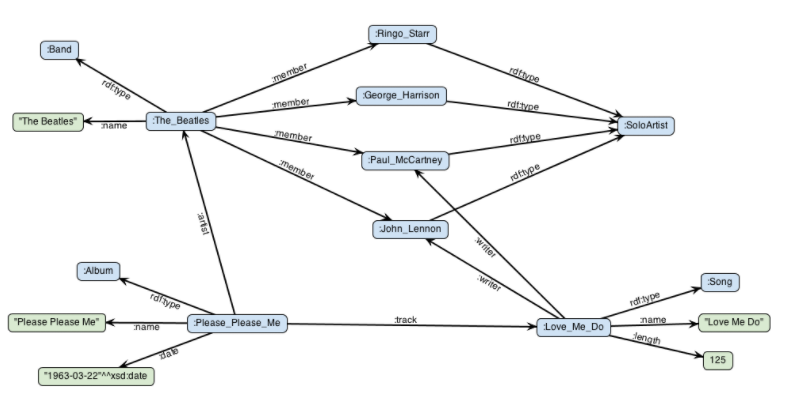

In [25]:
import rdflib
g = rdflib.Graph()

qres = g.query(
    """
    PREFIX dcat: <http://www.w3.org/ns/dcat#>
    PREFIX dcterms: <http://purl.org/dc/terms/>
    PREFIX owl: <http://www.w3.org/2002/07/owl#>
    PREFIX qb: <http://purl.org/linked-data/cube#>
    PREFIX rdf: <http://www.w3.org/1999/02/22-rdf-syntax-ns#>
    PREFIX rdfs: <http://www.w3.org/2000/01/rdf-schema#>
    PREFIX sdmx: <http://purl.org/linked-data/sdmx/2009/concept#>
    PREFIX skos: <http://www.w3.org/2004/02/skos/core#>
    PREFIX void: <http://rdfs.org/ns/void#>
    PREFIX xsd: <http://www.w3.org/2001/XMLSchema#>

    SELECT *
    WHERE {
      ?s ?p ?o
    }

    LIMIT 100
    """
)

for row in qres:
    print(row.s)

Hmm that didn't work as the query returns nothing - not sure how you link it to the database

although ONS also have a JSON api which makes things alot easier -http://statistics.data.gov.uk/sparql
- the sparql query is passed as a string as the "query" key in the html post

In [26]:
import requests
import json

url = 'http://statistics.data.gov.uk/sparql.json'
data = {
    'query': 'SELECT * WHERE {?s ?p ?o} LIMIT 2'
}
r = requests.post(url, data)

print(json.dumps(json.loads(r.content.decode()), indent=2))

{
  "head": {
    "vars": [
      "s",
      "p",
      "o"
    ]
  },
  "results": {
    "bindings": [
      {
        "s": {
          "type": "uri",
          "value": "http://statistics.data.gov.uk/id/statistical-geography/E00000001"
        },
        "p": {
          "type": "uri",
          "value": "http://www.w3.org/1999/02/22-rdf-syntax-ns#type"
        },
        "o": {
          "type": "uri",
          "value": "http://statistics.data.gov.uk/def/statistical-geography#Statistical-Geography"
        }
      },
      {
        "s": {
          "type": "uri",
          "value": "http://statistics.data.gov.uk/id/statistical-geography/E00000001"
        },
        "p": {
          "type": "uri",
          "value": "http://www.w3.org/2000/01/rdf-schema#label"
        },
        "o": {
          "type": "literal",
          "value": "E00000001"
        }
      }
    ]
  }
}


Now can try query with a filter to the code "K04000001"

In [27]:
query = """
    PREFIX  sg: <http://statistics.data.gov.uk/id/statistical-geography/>
    PREFIX  foi: <http://publishmydata.com/def/ontology/foi/>
    PREFIX  idn: <http://opendatacommunities.org/id/geography/administration/md/>
    PREFIX  ew: <http://opendatacommunities.org/id/geography/administration/e&w/>
    SELECT * WHERE { 
        ew:K04000001 ?p ?o .
    } LIMIT 100
"""
url = 'http://opendatacommunities.org/sparql.json'
r = requests.post(url, {'query': query})
print(json.dumps(json.loads(r.content.decode()), indent=2))

{
  "head": {
    "vars": [
      "p",
      "o"
    ]
  },
  "results": {
    "bindings": [
      {
        "p": {
          "type": "uri",
          "value": "http://www.w3.org/1999/02/22-rdf-syntax-ns#type"
        },
        "o": {
          "type": "uri",
          "value": "http://opendatacommunities.org/def/ontology/admingeo/Country"
        }
      },
      {
        "p": {
          "type": "uri",
          "value": "http://www.w3.org/2000/01/rdf-schema#label"
        },
        "o": {
          "xml:lang": "en",
          "type": "literal",
          "value": "England and Wales K04000001"
        }
      },
      {
        "p": {
          "type": "uri",
          "value": "http://www.w3.org/2004/02/skos/core#note"
        },
        "o": {
          "type": "literal",
          "value": "Live"
        }
      },
      {
        "p": {
          "type": "uri",
          "value": "http://www.w3.org/2004/02/skos/core#notation"
        },
        "o": {
          "type": "litera

# Gov Statistics vs Open Data Community sites

In the example below from the business activity spreadsheet, *Gateshead* is a child of *Tyne and Wear*

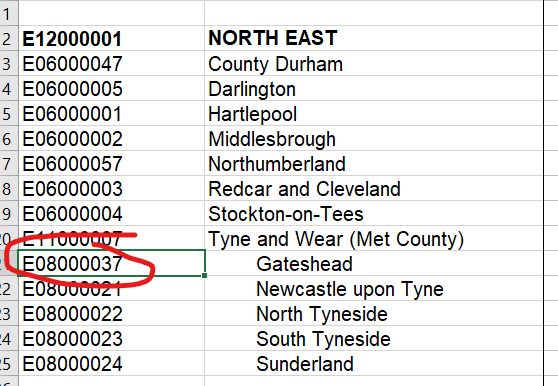

In the statistics.gov website below, the parent is reported as the region E12000001 **and not the county** E11000007?

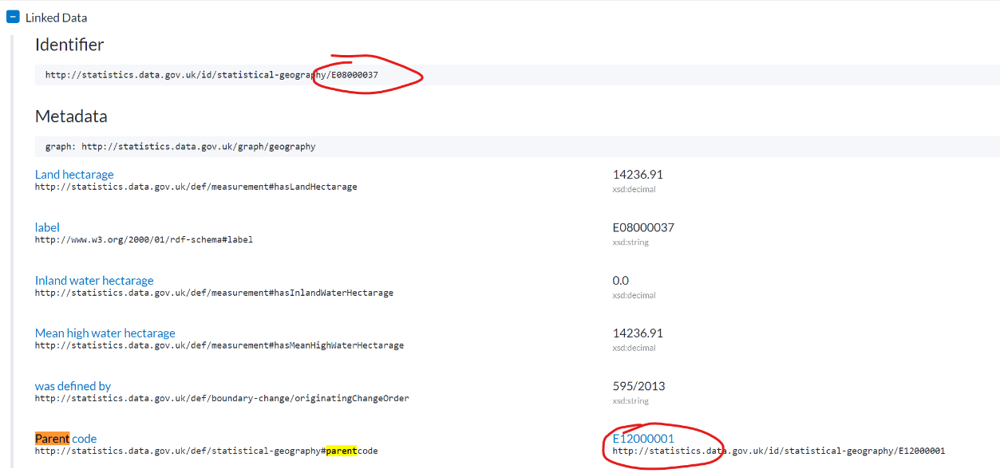

However, on the opencommunities website the parent is correctly listed as the county E11000007?
- thus, from now on going to use the **open communities website**

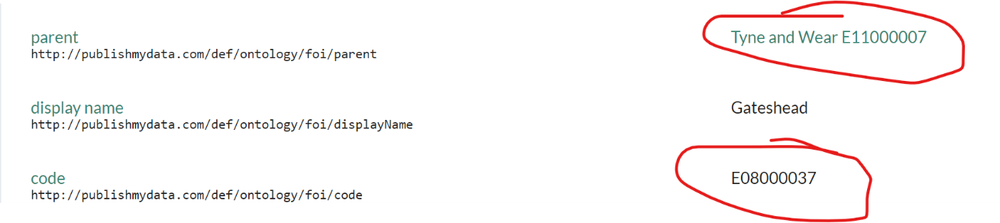

# Getting IRI

In open data communities different level of codes have different prefixes in the IRI, for example
- for the uk the prefix is "uk/": "http://opendatacommunities.org/id/geography/administration/uk/K02000001"
- for the gateshead region the prefix is "md/": "http://opendatacommunities.org/id/geography/administration/md/E08000037"

Thus, need to filter to the node with the "code" stored as a string, and from there detect the IRI

In [28]:
query = """
    PREFIX  sg: <http://statistics.data.gov.uk/id/statistical-geography/>
    PREFIX  foi: <http://publishmydata.com/def/ontology/foi/>
    PREFIX  idn: <http://opendatacommunities.org/id/geography/administration/md/>
    PREFIX  ew: <http://opendatacommunities.org/id/geography/administration/e&w/>
    SELECT * WHERE { 
        ?c foi:code "K02000001" .
    } LIMIT 100
"""
url = 'http://opendatacommunities.org/sparql.json'
r = requests.post(url, {'query': query})
print(json.dumps(json.loads(r.content.decode()), indent=2))

{
  "head": {
    "vars": [
      "c"
    ]
  },
  "results": {
    "bindings": [
      {
        "c": {
          "type": "uri",
          "value": "http://opendatacommunities.org/id/geography/administration/uk/K02000001"
        }
      }
    ]
  }
}


Code below defines and calls a function which takes an ONS code and gets the URI from open data communities

In [29]:
class SparqlException(Exception):
    pass

def get_uri(code: str) -> str:
    query = f"""
        PREFIX  foi: <http://publishmydata.com/def/ontology/foi/>
        SELECT * WHERE {{ 
            ?c foi:code "{code}" .
        }} LIMIT 100
    """
    url = 'http://opendatacommunities.org/sparql.json'
    r = requests.post(url, {'query': query})
    data = json.loads(r.content.decode())
    for b in data["results"]["bindings"]:
        if b["c"]["type"] == "uri":
            return b["c"]["value"]
    raise SparqlException(f'no "uri" type found in bindings for code "{code}"')
get_uri("K02000001")

'http://opendatacommunities.org/id/geography/administration/uk/K02000001'

# Parent URI

Taking a sample URI for area code "E07000026", get the response trying to obtain its parent URI

In [30]:
uri = 'http://opendatacommunities.org/id/geography/administration/nmd/E07000026'
query = f"""
    PREFIX  foi: <http://publishmydata.com/def/ontology/foi/>
    SELECT * WHERE {{ 
        <{uri}> foi:parent ?c .
    }} LIMIT 100
"""
url = 'http://opendatacommunities.org/sparql.json'
r = requests.post(url, {'query': query})
print(json.dumps(json.loads(r.content.decode()), indent=2))

{
  "head": {
    "vars": [
      "c"
    ]
  },
  "results": {
    "bindings": [
      {
        "c": {
          "type": "uri",
          "value": "http://opendatacommunities.org/id/geography/administration/cty/E10000006"
        }
      }
    ]
  }
}


Create function to extract code parent

In [31]:
type(r)

requests.models.Response

In [32]:
from typing import Optional
from requests.models import Response

def extract_value(response: Response, var_name: str, conn_type: str) -> any:
    data = json.loads(response.content.decode())
    for b in data["results"]["bindings"]:
        if b[var_name]["type"] == conn_type:
            return b[var_name]["value"]
    raise SparqlException(f'no "{conn_type}" type found in bindings')

def get_parent(uri: str) -> Optional[str]:
    # URI must be encapsulated in <> angular brackets for sparql to function
    query = f"""
        PREFIX  foi: <http://publishmydata.com/def/ontology/foi/>
        SELECT * WHERE {{ 
            <{uri}> foi:parent ?c .
        }} LIMIT 100
    """
    url = 'http://opendatacommunities.org/sparql.json'
    r = requests.post(url, {'query': query})
    try:
        return extract_value(r, "c", "uri")
    except SparqlException:
        return None
    
get_parent('http://opendatacommunities.org/id/geography/administration/cty/E10000006')

'http://opendatacommunities.org/id/geography/administration/rgn/E12000002'

Now, can apply function to dataframe first index column of geographical codes and get URI

In [33]:
for r in df3.index[:5]:
    try:
        print(get_uri(r[0]))
    except SparqlException as e:
        print(e)
        break

http://opendatacommunities.org/id/geography/administration/uk/K02000001
http://opendatacommunities.org/id/geography/administration/gb/K03000001
no "uri" type found in bindings for code "K04000001"


# Multiple URLs

So it would seem that some codes dont exist in the opendatacommunities site, so can try gov statistics site as well as a backup

In [34]:
URLS = [
    'http://opendatacommunities.org/sparql.json',
    'http://statistics.data.gov.uk/sparql.json'
]

def extract_value(response: Response, var_name: str, conn_type: str) -> any:
    data = json.loads(response.content.decode())
    for b in data["results"]["bindings"]:
        if b[var_name]["type"] == conn_type:
            return b[var_name]["value"]
    return None

# def try_urls(code: str, query: str, var_name: str, conn_type: str) -> any:
#     for url in URLS:
#         response = requests.post(url, {'query': query})
#         result = extract_value(response, var_name, conn_type)
#         if result is not None:
#             if type(result) is not str:
#                 raise SparqlException(f'code "{code}", expected string, got {type(result)}')
#             return result
#     return None
        
def get_uri(code: str) -> str:
    query = f"""
        PREFIX  foi: <http://publishmydata.com/def/ontology/foi/>
        SELECT * WHERE {{ 
            ?c foi:code "{code}" .
        }} LIMIT 100
    """
    result = None
    for url in URLS:
        response = requests.post(url, {'query': query})
        result = extract_value(response, "c", "uri")
        if result is not None:
            if type(result) is not str:
                raise SparqlException(f'code "{code}", expected string, got {type(result)}')
            return result
        
    raise SparqlException(f'no "uri" type found in bindings for code "{code}"')

def get_parent(uri: str) -> Optional[str]:
    # URI must be encapsulated in <> angular brackets for sparql to function
    query = f"""
        PREFIX  foi: <http://publishmydata.com/def/ontology/foi/>
        SELECT * WHERE {{ 
            <{uri}> foi:parent ?c .
        }} LIMIT 100
    """
    result = None
    for url in URLS:
        response = requests.post(url, {'query': query})
        result = extract_value(response, "c", "uri")
        if result is not None:
            if type(result) is not str:
                raise SparqlException(f'expected string, got {type(result)}')
            return result
    raise SparqlException(f'no "uri" type found in bindings for uri "{uri}"')
   
    

In [35]:
get_parent(get_uri('K03000001'))

'http://opendatacommunities.org/id/geography/administration/uk/K02000001'

(only do last few so notebook doesnt take ages to re-run)...

In [36]:
for r in df3.index[-30:]:
    try:
        uri = get_uri(r[0])
        print(uri)
        parent = get_parent(uri)
        print(parent)
    except SparqlException as e:
        print(e)


http://statistics.data.gov.uk/id/statistical-geography/S12000049
no "uri" type found in bindings for uri "http://statistics.data.gov.uk/id/statistical-geography/S12000049"
http://statistics.data.gov.uk/id/statistical-geography/S12000017
no "uri" type found in bindings for uri "http://statistics.data.gov.uk/id/statistical-geography/S12000017"
http://statistics.data.gov.uk/id/statistical-geography/S12000018
no "uri" type found in bindings for uri "http://statistics.data.gov.uk/id/statistical-geography/S12000018"
http://statistics.data.gov.uk/id/statistical-geography/S12000019
no "uri" type found in bindings for uri "http://statistics.data.gov.uk/id/statistical-geography/S12000019"
http://statistics.data.gov.uk/id/statistical-geography/S12000020
no "uri" type found in bindings for uri "http://statistics.data.gov.uk/id/statistical-geography/S12000020"
http://statistics.data.gov.uk/id/statistical-geography/S12000013
no "uri" type found in bindings for uri "http://statistics.data.gov.uk/id/s

So the northern ireland "parent" lookups dont work, apparently they have their own website for linked geography data 

# Adding NI and Scotland

can see an example here from NI site: http://linked.nisra.gov.uk/atlas/resource?uri=http%3A%2F%2Fstatistics.data.gov.uk%2Fid%2Fstatistical-geography%2FN09000010&inactive=false

The sparql site is here: http://linked.nisra.gov.uk/sparql

In [37]:
URLS = [
    'http://opendatacommunities.org/sparql.json',
    'http://statistics.data.gov.uk/sparql.json',
    'http://linked.nisra.gov.uk/sparql.json'
]

In [38]:
from typing import Optional, Dict

def extract_value(response: Response, var_name: str, conn_type: str) -> any:
    """
    parse an html response to JSON and extract sparql query response data, return None if not found
    """
    if not response.content:
        return None
    data = json.loads(response.content.decode())
    for b in data["results"]["bindings"]:
        if b[var_name]["type"] == conn_type:
            return b[var_name]["value"]
    return None

def generate_uri_query(code: str) -> str:
    """
    generate query that matches an RDF predicate of a geographical code type and an RDF object of the code passed as a parameter
    query provides result in the "c" variable to match a URI from the string code passed to the function
    """
    return f"""
        PREFIX  foi: <http://publishmydata.com/def/ontology/foi/>
        SELECT * WHERE {{ 
            ?c foi:code "{code}" .
        }} LIMIT 100
    """

def generate_parent_query(uri: str) -> str:
    """
    generate a query to capture the parent URI from an existing URI in the variable "c"
    """
    
    # URI must be encapsulated in <> angular brackets for sparql to function
    return f"""
        PREFIX  foi: <http://publishmydata.com/def/ontology/foi/>
        SELECT * WHERE {{ 
            <{uri}> foi:parent ?c .
        }} LIMIT 100
    """

def generate_code_query(uri: str) -> str:
    """
    generate a query to capture the string code from a URI into a variable "c"
    """
    return f"""
        PREFIX  foi: <http://publishmydata.com/def/ontology/foi/>
        SELECT * WHERE {{ 
            <{uri}> foi:code ?c .
        }} LIMIT 100
    """
    

def execute_sparql(url: str, query: str) -> Response:
    """execute a sparql query"""
    return requests.post(url, {'query': query})


def get_info(code: str) -> Optional[Dict]:
    for url in URLS:
        query = generate_uri_query(code)
        response = execute_sparql(url, query)
        uri = extract_value(response, "c", "uri")
        if uri is not None:
            parent_query = generate_parent_query(uri)
            response = execute_sparql(url, parent_query)
            parent_uri = extract_value(response, "c", "uri")
            if parent_uri is not None:
                return {
                    'uri': uri,
                    'parent_uri': parent_uri
                }
    return None
    

In [39]:
for r in df3.index[-30:]:
    code = r[0]
    info = get_info(code)
    if info is not None:
        print(f'code: "{code}"')
        print(f'uri: "{info["uri"]}"')
        print(f'parent uri: "{info["parent_uri"]}"')
    else:
        print(f'could not find parent info for "{code}"')

could not find parent info for "S12000049"
could not find parent info for "S12000017"
could not find parent info for "S12000018"
could not find parent info for "S12000019"
could not find parent info for "S12000020"
could not find parent info for "S12000013"
could not find parent info for "S12000021"
could not find parent info for "S12000050"
could not find parent info for "S12000023"
could not find parent info for "S12000048"
could not find parent info for "S12000038"
could not find parent info for "S12000026"
could not find parent info for "S12000027"
could not find parent info for "S12000028"
could not find parent info for "S12000029"
could not find parent info for "S12000030"
could not find parent info for "S12000039"
could not find parent info for "S12000040"
code: "N92000002"
uri: "http://opendatacommunities.org/id/geography/administration/ctry/N92000002"
parent uri: "http://opendatacommunities.org/id/geography/administration/uk/K02000001"
code: "N09000001"
uri: "http://statistics

Adding in scotland as well... http://statistics.gov.scot/sparql

In [40]:
URLS = [
    'http://opendatacommunities.org/sparql.json',
    'http://statistics.data.gov.uk/sparql.json',
    'http://linked.nisra.gov.uk/sparql.json',
    'http://statistics.gov.scot/sparql.json'
]

# Parent Codes

Now running for all indexes, it should work for all except
- UK as the top of the tree has no parent
- England & Wales K04000001 doesn't have a parent, doesnt appear to work

In [41]:
for r in df3.index[-30:]:
    code = r[0]
    info = get_info(code)
    if info is not None:
        print(f'code: "{code}"')
        print(f'uri: "{info["uri"]}"')
        print(f'parent uri: "{info["parent_uri"]}"')
    else:
        print(f'could not find parent info for "{code}"')

code: "S12000049"
uri: "http://statistics.gov.scot/id/statistical-geography/S12000049"
parent uri: "http://statistics.gov.scot/id/statistical-geography/S92000003"
code: "S12000017"
uri: "http://statistics.gov.scot/id/statistical-geography/S12000017"
parent uri: "http://statistics.gov.scot/id/statistical-geography/S92000003"
code: "S12000018"
uri: "http://statistics.gov.scot/id/statistical-geography/S12000018"
parent uri: "http://statistics.gov.scot/id/statistical-geography/S92000003"
code: "S12000019"
uri: "http://statistics.gov.scot/id/statistical-geography/S12000019"
parent uri: "http://statistics.gov.scot/id/statistical-geography/S92000003"
code: "S12000020"
uri: "http://statistics.gov.scot/id/statistical-geography/S12000020"
parent uri: "http://statistics.gov.scot/id/statistical-geography/S92000003"
code: "S12000013"
uri: "http://statistics.gov.scot/id/statistical-geography/S12000013"
parent uri: "http://statistics.gov.scot/id/statistical-geography/S92000003"
code: "S12000021"
uri:

Now, can test out getting the parent string code once we have its URI

In [42]:
sample_code = "E92000001"
sample_url = "http://opendatacommunities.org/sparql.json"
q = generate_code_query("http://opendatacommunities.org/id/geography/administration/ctry/E92000001")
response = execute_sparql(sample_url, q)
response.content

b'{"head":{"vars":["c"]},"results":{"bindings":[{"c":{"type":"literal","value":"E92000001"}}]}}'

In [43]:
extract_value(response, "c", "literal")

'E92000001'

Update info retriever function to get parent code as well

In [44]:
def get_info(code: str, require_parent=True) -> Optional[Dict]:
    for url in URLS:
        query = generate_uri_query(code)
        response = execute_sparql(url, query)
        uri = extract_value(response, "c", "uri")
        if uri is None:
            continue
        
        if not require_parent:
            return {'uri': uri}
        
        parent_query = generate_parent_query(uri)
        response = execute_sparql(url, parent_query)
        parent_uri = extract_value(response, "c", "uri")
        if parent_uri is None:
            continue
            
        code_query = generate_code_query(parent_uri)
        response = execute_sparql(url, code_query)
        parent_code = extract_value(response, "c", "literal")
        
        if parent_code is None:
            continue
        
        return {
            'uri': uri,
            'parent_uri': parent_uri,
            'parent_code': parent_code
        }
    return {}

- only do top codes so re-running notebook doesnt take forever

In [45]:
top_code = 'K02000001'
infos = [get_info(i[0], require_parent=i[0]!=top_code) for i in df3.index[:30]]

In [46]:
df4 = pandas.DataFrame(infos, index=df3.index[:30])
df4

,,uri,parent_uri,parent_code
K02000001,UNITED KINGDOM,http://opendatacommunities.org/id/geography/ad...,NaN,NaN
K03000001,GREAT BRITAIN,http://opendatacommunities.org/id/geography/ad...,http://opendatacommunities.org/id/geography/ad...,K02000001
K04000001,ENGLAND AND WALES,NaN,NaN,NaN
E92000001,ENGLAND,http://opendatacommunities.org/id/geography/ad...,http://opendatacommunities.org/id/geography/ad...,K03000001
E12000001,NORTH EAST,http://opendatacommunities.org/id/geography/ad...,http://opendatacommunities.org/id/geography/ad...,E92000001
E06000047,County Durham,http://opendatacommunities.org/id/geography/ad...,http://opendatacommunities.org/id/geography/ad...,E12000001
E06000005,Darlington,http://opendatacommunities.org/id/geography/ad...,http://opendatacommunities.org/id/geography/ad...,E12000001
E06000001,Hartlepool,http://opendatacommunities.org/id/geography/ad...,http://opendatacommunities.org/id/geography/ad...,E12000001
E06000002,Middlesbrough,http://opendatacommunities.org/id/geography/ad...,http://opendatacommunities.org/id/geography/ad...,E12000001
E06000057,Northumberland,http://opendatacommunities.org/id/geography/ad...,http://opendatacommunities.org/id/geography/ad...,E12000001


# Manual adjustments

From the dataframe above, it seems that met counties (E11) are mapping to the county (E92), instead of the region (E12)

From the dataset here, can see mappings from counties to regions: https://geoportal.statistics.gov.uk/datasets/ons::local-authority-district-to-county-april-2021-lookup-in-england/about

In [47]:
p = "excel-files/Ward_to_Local_Authority_District_to_County_to_Region_to_Country__December_2020__Lookup_in_United_Kingdom_V2.csv"
dfl = pandas.read_csv(p)

In [48]:
dfl.head()

,FID,WD20CD,WD20NM,LAD20CD,LAD20NM,CTY20CD,CTY20NM,RGN20CD,RGN20NM,CTRY20CD,CTRY20NM
0,1,E05008942,Burn Valley,E06000001,Hartlepool,NaN,NaN,E12000001,North East,E92000001,England
1,2,E05008943,De Bruce,E06000001,Hartlepool,NaN,NaN,E12000001,North East,E92000001,England
2,3,E05008944,Fens and Rossmere,E06000001,Hartlepool,NaN,NaN,E12000001,North East,E92000001,England
3,4,E05008945,Foggy Furze,E06000001,Hartlepool,NaN,NaN,E12000001,North East,E92000001,England
4,5,E05008946,Hart,E06000001,Hartlepool,NaN,NaN,E12000001,North East,E92000001,England


Extract county and regional codes

In [49]:
dfc = dfl[['CTY20CD', 'RGN20CD']]
dfc.head()

,CTY20CD,RGN20CD
0,NaN,E12000001
1,NaN,E12000001
2,NaN,E12000001
3,NaN,E12000001
4,NaN,E12000001


In [50]:
dfc2 = dfc.drop_duplicates(['CTY20CD']).dropna()
dfc2

,CTY20CD,RGN20CD
1600,E10000006,E12000002
1616,E10000003,E12000006
1694,E10000007,E12000004
2000,E10000008,E12000009
2010,E10000011,E12000008
2400,E10000012,E12000006
2451,E10000013,E12000009
2771,E10000014,E12000008
2801,E10000016,E12000008
2823,E10000015,E12000006


Now, create a table to map England and Wales to K04000001 (England and Wales), and K04000001 to Great Britain

In [51]:
df_ew = pandas.DataFrame([
    {
        'code': 'E92000001',
        'parent': 'K04000001'
    }, {
        'code': 'W92000004',
        'parent': 'K04000001'
    }, {
        'code': 'K04000001',
        'parent': 'K03000001'
    }
])
df_ew = df_ew.set_index('code')
df_ew

,parent
code,
E92000001,K04000001
W92000004,K04000001
K04000001,K03000001


Set county as index

In [52]:
dfc3 = dfc2.set_index('CTY20CD')
dfc3 = dfc3.rename(columns={'RGN20CD': 'parent'})
dfc3.head()

,parent
CTY20CD,
E10000006,E12000002
E10000003,E12000006
E10000007,E12000004
E10000008,E12000009
E10000011,E12000008


Join county/region and manual lookups into single dataframe

In [53]:
dflookups = pandas.concat([df_ew, dfc3])
dflookups.head(10)

,parent
E92000001,K04000001
W92000004,K04000001
K04000001,K03000001
E10000006,E12000002
E10000003,E12000006
E10000007,E12000004
E10000008,E12000009
E10000011,E12000008
E10000012,E12000006
E10000013,E12000009


Check indexing works

In [54]:
'W92000004' in dflookups.index

True

In [55]:
dflookups['parent']['W92000004']

'K04000001'

Generate parent code mappings again
- this time if code exists in the manual lookups dataframe, parent code will be extracted rather than querying the API

In [56]:
top_code = 'K02000001'
infos2 = []
for i in tqdm(df3.index):
    code = i[0]
    require_parent = code != top_code
    in_lookups = code in dflookups.index
    d = get_info(code, False if in_lookups else require_parent)
    if in_lookups:
        d['parent_code'] = dflookups['parent'][code]
    infos2.append(d)
dffinal = pandas.DataFrame(infos2, index=df3.index)

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 428/428 [02:27<00:00,  2.90it/s]


In [57]:
dffinal.head()

,,uri,parent_uri,parent_code
K02000001,UNITED KINGDOM,http://opendatacommunities.org/id/geography/ad...,NaN,NaN
K03000001,GREAT BRITAIN,http://opendatacommunities.org/id/geography/ad...,http://opendatacommunities.org/id/geography/ad...,K02000001
K04000001,ENGLAND AND WALES,http://statistics.data.gov.uk/id/statistical-g...,NaN,K03000001
E92000001,ENGLAND,http://opendatacommunities.org/id/geography/ad...,NaN,K04000001
E12000001,NORTH EAST,http://opendatacommunities.org/id/geography/ad...,http://opendatacommunities.org/id/geography/ad...,E92000001


# WKT to GeoJSON

The statistics.gov site provides geographical spatial data in the form on WKT, but mapbox (for the front end) uses GeoJSON, so need to convert from WKT to GeoJSON

Testing a script from github here to convert wkt to geojson: https://gist.github.com/drmalex07/5a54fc4f1db06a66679e#file-convert-wkt-to-geojson-py

In [58]:
import geojson
import shapely.wkt

s = '''POLYGON ((23.314208 37.768469, 24.039306 37.768469, 24.039306 38.214372, 23.314208 38.214372, 23.314208 37.768469))'''

# Convert to a shapely.geometry.polygon.Polygon object
g1 = shapely.wkt.loads(s)

g2 = geojson.Feature(geometry=g1, properties={})

print(json.dumps(g2.geometry, indent=2))

{
  "type": "Polygon",
  "coordinates": [
    [
      [
        23.314208,
        37.768469
      ],
      [
        24.039306,
        37.768469
      ],
      [
        24.039306,
        38.214372
      ],
      [
        23.314208,
        38.214372
      ],
      [
        23.314208,
        37.768469
      ]
    ]
  ]
}


Put into function

In [59]:
def wkt_to_geojson(wkt_data: str, geo_id=None) -> geojson.feature.Feature:
    g1 = shapely.wkt.loads(wkt_data)
    g2 = geojson.Feature(geometry=g1, properties={}, id=geo_id)
    return g2

# Geometry from API

API provides a node to get geometry data - see example with england here: http://statistics.data.gov.uk/atlas/resource?uri=http%3A%2F%2Fstatistics.data.gov.uk%2Fid%2Fstatistical-geography%2FE92000001&inactive=false

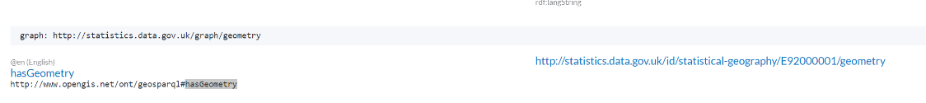

In [60]:
england_uri = 'http://statistics.data.gov.uk/id/statistical-geography/E92000001'

In [61]:
stats_url = 'http://statistics.data.gov.uk/sparql.json'

In [62]:
def generate_geometry_query(uri: str) -> str:
    """
    generate query that matches an RDF predicate of a hasGeometry type and uri passed to function
    query provides result in the "c" variable
    """
    return f"""
        PREFIX  foi: <http://publishmydata.com/def/ontology/foi/>
        PREFIX  geosparql: <http://www.opengis.net/ont/geosparql#>
        SELECT * WHERE {{ 
            <{uri}> geosparql:hasGeometry ?c .
        }} LIMIT 100
    """
def display(content: bytes):
    print(json.dumps(json.loads(content.decode()), indent=2))
    

In [63]:
gq = generate_geometry_query(england_uri)
response = execute_sparql(stats_url, gq)
display(response.content)

{
  "head": {
    "vars": [
      "c"
    ]
  },
  "results": {
    "bindings": [
      {
        "c": {
          "type": "uri",
          "value": "http://statistics.data.gov.uk/id/statistical-geography/E92000001/geometry"
        }
      }
    ]
  }
}


In [64]:
help(extract_value)

Help on function extract_value in module __main__:

extract_value(response: requests.models.Response, var_name: str, conn_type: str) -> <built-in function any>
    parse an html response to JSON and extract sparql query response data, return None if not found



In [65]:
geo_uri = extract_value(response, "c", "uri")
geo_uri

'http://statistics.data.gov.uk/id/statistical-geography/E92000001/geometry'

Now the actual GEO data is contained in a node called "asWKT"

In [66]:
geo_uri

'http://statistics.data.gov.uk/id/statistical-geography/E92000001/geometry'

In [67]:
def generate_wkt_query(uri: str) -> str:
    """
    generate query that matches an RDF subject of a URI for a geomtry node and a predicate of type "asWKT"
    query provides result in the "c" variable
    """
    return f"""
        PREFIX  geosparql: <http://www.opengis.net/ont/geosparql#>
        SELECT * WHERE {{ 
            <{uri}>  geosparql:asWKT ?c .
        }} LIMIT 100
    """

Response will contain a large amount of JSONd data so check length

In [68]:
wktq = generate_wkt_query(geo_uri)
wkt_response = execute_sparql(stats_url, wktq)
print(len(wkt_response.content))

2785961


# Plotly map plot

Can use plotly to test the geojson plotting, taking an example from their website https://plotly.com/python/mapbox-county-choropleth/
- To display the map, **need jupyterlab-chart-editor extension installed**

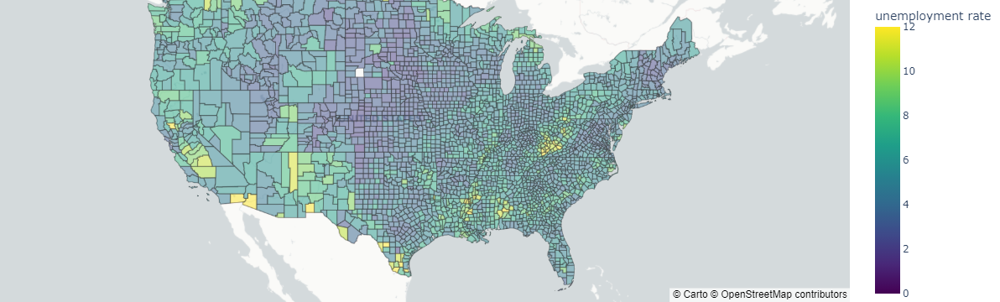

In [69]:
from urllib.request import urlopen
import json
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)

import pandas as pd
df = pd.read_csv("https://raw.githubusercontent.com/plotly/datasets/master/fips-unemp-16.csv",
                   dtype={"fips": str})

import plotly.express as px

fig = px.choropleth_mapbox(df, geojson=counties, locations='fips', color='unemp',
                           color_continuous_scale="Viridis",
                           range_color=(0, 12),
                           mapbox_style="carto-positron",
                           zoom=3, center = {"lat": 37.0902, "lon": -95.7129},
                           opacity=0.5,
                           labels={'unemp':'unemployment rate'}
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

# England Sample Plot

Now going to test plotting the geojson data from the sample code using england E92000001<br>
Firstly need to extract the response

In [70]:
wkt_data = extract_value(wkt_response, "c", "literal")
wkt_data[:100]

'MULTIPOLYGON (((-2.669520244831496 51.74272427131478, -2.668560523453166 51.744957948642906, -2.6650'

Convert the WKT to GeoJSON data and check it is a valid dictionary

In [71]:
eng_geo = wkt_to_geojson(wkt_data)

In [72]:
type(eng_geo)

geojson.feature.Feature

In [73]:
isinstance(eng_geo, dict)

True

Write to file for inspection

In [74]:
with open('E92000001.json', 'w') as f:
    f.write(json.dumps(eng_geo))

Do sample plot using plotly mapbox
- sample value is given for england code E92000001
- "id" must be written to geojson entry to be ready by plotly express
- map centered at london

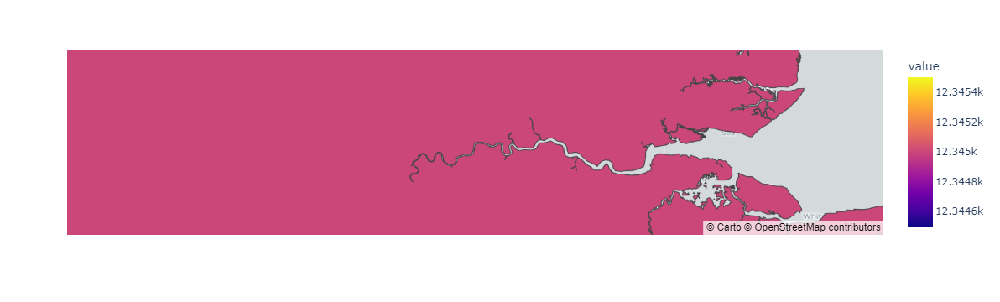

In [75]:
df_eng = pandas.DataFrame([{
    'code': 'E92000001',
    'value': 12345
}])
eng_geo['id'] = 'E92000001'
london_lat_lon = [51.509865, -0.118092]
px.choropleth_mapbox(
    df_eng, 
    geojson=eng_geo, 
    locations="code", 
    color="value", 
    mapbox_style="carto-positron",
    center = {
        "lat": london_lat_lon[0], 
        "lon": london_lat_lon[1]
    }
)

# Generating GeoJSON

Iterate through dataframe geographical codes get geojson data, combine all and store as a feature collection

In [76]:
help(extract_value)

Help on function extract_value in module __main__:

extract_value(response: requests.models.Response, var_name: str, conn_type: str) -> <built-in function any>
    parse an html response to JSON and extract sparql query response data, return None if not found



In [77]:
def perform_sparql(url: str, query: str, var_name: str, conn_type: str):
    """execute a sparql query `query` to url `url`, and extract data using sparql variable name `var_name` with connection type `conn_type`"""
    response = execute_sparql(url, query)
    return extract_value(response, var_name, conn_type)

In [78]:
dffinal.head()

,,uri,parent_uri,parent_code
K02000001,UNITED KINGDOM,http://opendatacommunities.org/id/geography/ad...,NaN,NaN
K03000001,GREAT BRITAIN,http://opendatacommunities.org/id/geography/ad...,http://opendatacommunities.org/id/geography/ad...,K02000001
K04000001,ENGLAND AND WALES,http://statistics.data.gov.uk/id/statistical-g...,NaN,K03000001
E92000001,ENGLAND,http://opendatacommunities.org/id/geography/ad...,NaN,K04000001
E12000001,NORTH EAST,http://opendatacommunities.org/id/geography/ad...,http://opendatacommunities.org/id/geography/ad...,E92000001


In [79]:
def extract_value_strict(response: Response, var_name: str, conn_type: str) -> any:
    """
    parse an html response to JSON and extract sparql query response data, return None if not found, raise Exception on error
    """
    if not response.content:
        raise SparqlException('cannot extract value, response content empty')
    data = json.loads(response.content.decode())
    for b in data["results"]["bindings"]:
        if b[var_name]["type"] == conn_type:
            return b[var_name]["value"]
    raise SparqlException(f'cannot extract value, var "{var_name}" doesnt exist with connection "{conn_type}"')

Look through geographical codes and get geojson data into list of geojson features

In [80]:
from typing import List
import traceback

features: List[geojson.feature.Feature] = []
for i in tqdm(dffinal.index):
    code = i[0]
    try:
        uri = perform_sparql(stats_url, generate_uri_query(code), "c", "uri")
        geo_uri = perform_sparql(stats_url, generate_geometry_query(uri), "c", "uri")
        wkt_data = perform_sparql(stats_url, generate_wkt_query(geo_uri), "c", "literal")
        ftr = wkt_to_geojson(wkt_data, geo_id=code)
        features.append(ftr)
    except (SparqlException, json.JSONDecodeError, KeyError, ValueError) as e:
        print(f'couldnt get data for code: "{code}"')
        print(traceback.format_exc())

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 428/428 [02:06<00:00,  3.40it/s]


Create feature collection and write to file

In [81]:
feature_collection = geojson.FeatureCollection(features)

In [82]:
with open('ukgeography.geojson', 'w') as f:
    f.write(json.dumps(feature_collection))

# SIC Hierachy

SIC codes from table 2 number over 600 rows 

In [83]:
import pandas as pd

In [84]:
dfs = pd.read_excel(
    "excel-files/sic2007summaryofstructurtcm6.xls", 
    header=1,
    dtype='str' # dont truncate strings starting with 0
)

In [85]:
dfs.head()

,SECTION,Unnamed: 1,Division,Unnamed: 3,Group,Unnamed: 5,Class,Unnamed: 7,Sub Class,Unnamed: 9
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,A,"AGRICULTURE, FORESTRY AND FISHING",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,NaN,NaN,01,"Crop and animal production, hunting and relate...",NaN,NaN,NaN,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN,01.1,Growing of non-perennial crops,NaN,NaN,NaN,NaN


In [86]:
newCols = {}
for i, col in enumerate(dfs.columns):
    if 'unnamed' in col.lower():
        newCols[col] = f'{dfs.columns[i-1]}-name'
dfs2 = dfs.rename(columns=newCols)
dfs2 = dfs2[[col for col in dfs2.columns if 'sub' not in col.lower()]]

In [87]:
dfs2.head()

,SECTION,SECTION-name,Division,Division-name,Group,Group-name,Class,Class-name
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,A,"AGRICULTURE, FORESTRY AND FISHING",NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,NaN,NaN,01,"Crop and animal production, hunting and relate...",NaN,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN,01.1,Growing of non-perennial crops,NaN,NaN


In [88]:
dfs3 = dfs2.fillna(method='ffill', axis=0).dropna()
dfs3.head()

,SECTION,SECTION-name,Division,Division-name,Group,Group-name,Class,Class-name
5,A,"AGRICULTURE, FORESTRY AND FISHING",01,"Crop and animal production, hunting and relate...",01.1,Growing of non-perennial crops,01.11,"Growing of cereals (except rice), leguminous c..."
6,A,"AGRICULTURE, FORESTRY AND FISHING",01,"Crop and animal production, hunting and relate...",01.1,Growing of non-perennial crops,01.12,Growing of rice
7,A,"AGRICULTURE, FORESTRY AND FISHING",01,"Crop and animal production, hunting and relate...",01.1,Growing of non-perennial crops,01.13,"Growing of vegetables and melons, roots and tu..."
8,A,"AGRICULTURE, FORESTRY AND FISHING",01,"Crop and animal production, hunting and relate...",01.1,Growing of non-perennial crops,01.14,Growing of sugar cane
9,A,"AGRICULTURE, FORESTRY AND FISHING",01,"Crop and animal production, hunting and relate...",01.1,Growing of non-perennial crops,01.15,Growing of tobacco


In [89]:
dfs3['class-code'] = dfs3['Class'].apply(lambda x: x.replace('.', ''))
dfs3.head()

,SECTION,SECTION-name,Division,Division-name,Group,Group-name,Class,Class-name,class-code
5,A,"AGRICULTURE, FORESTRY AND FISHING",01,"Crop and animal production, hunting and relate...",01.1,Growing of non-perennial crops,01.11,"Growing of cereals (except rice), leguminous c...",0111
6,A,"AGRICULTURE, FORESTRY AND FISHING",01,"Crop and animal production, hunting and relate...",01.1,Growing of non-perennial crops,01.12,Growing of rice,0112
7,A,"AGRICULTURE, FORESTRY AND FISHING",01,"Crop and animal production, hunting and relate...",01.1,Growing of non-perennial crops,01.13,"Growing of vegetables and melons, roots and tu...",0113
8,A,"AGRICULTURE, FORESTRY AND FISHING",01,"Crop and animal production, hunting and relate...",01.1,Growing of non-perennial crops,01.14,Growing of sugar cane,0114
9,A,"AGRICULTURE, FORESTRY AND FISHING",01,"Crop and animal production, hunting and relate...",01.1,Growing of non-perennial crops,01.15,Growing of tobacco,0115


In [90]:
dfs4 = dfs3.set_index('class-code')
dfs4.head()

,SECTION,SECTION-name,Division,Division-name,Group,Group-name,Class,Class-name
class-code,,,,,,,,
0111,A,"AGRICULTURE, FORESTRY AND FISHING",01,"Crop and animal production, hunting and relate...",01.1,Growing of non-perennial crops,01.11,"Growing of cereals (except rice), leguminous c..."
0112,A,"AGRICULTURE, FORESTRY AND FISHING",01,"Crop and animal production, hunting and relate...",01.1,Growing of non-perennial crops,01.12,Growing of rice
0113,A,"AGRICULTURE, FORESTRY AND FISHING",01,"Crop and animal production, hunting and relate...",01.1,Growing of non-perennial crops,01.13,"Growing of vegetables and melons, roots and tu..."
0114,A,"AGRICULTURE, FORESTRY AND FISHING",01,"Crop and animal production, hunting and relate...",01.1,Growing of non-perennial crops,01.14,Growing of sugar cane
0115,A,"AGRICULTURE, FORESTRY AND FISHING",01,"Crop and animal production, hunting and relate...",01.1,Growing of non-perennial crops,01.15,Growing of tobacco


# Database

First (for now), going to extract geographical names into own column

In [91]:
dffinal['name'] = dffinal.index.get_level_values(level=1)
dffinal.head()

,,uri,parent_uri,parent_code,name
K02000001,UNITED KINGDOM,http://opendatacommunities.org/id/geography/ad...,NaN,NaN,UNITED KINGDOM
K03000001,GREAT BRITAIN,http://opendatacommunities.org/id/geography/ad...,http://opendatacommunities.org/id/geography/ad...,K02000001,GREAT BRITAIN
K04000001,ENGLAND AND WALES,http://statistics.data.gov.uk/id/statistical-g...,NaN,K03000001,ENGLAND AND WALES
E92000001,ENGLAND,http://opendatacommunities.org/id/geography/ad...,NaN,K04000001,ENGLAND
E12000001,NORTH EAST,http://opendatacommunities.org/id/geography/ad...,http://opendatacommunities.org/id/geography/ad...,E92000001,NORTH EAST


Now can replace index with just first level containing the geographical code

In [92]:
dffinal.index = dffinal.index.get_level_values(level=0)
dffinal.head()

,uri,parent_uri,parent_code,name
K02000001,http://opendatacommunities.org/id/geography/ad...,NaN,NaN,UNITED KINGDOM
K03000001,http://opendatacommunities.org/id/geography/ad...,http://opendatacommunities.org/id/geography/ad...,K02000001,GREAT BRITAIN
K04000001,http://statistics.data.gov.uk/id/statistical-g...,NaN,K03000001,ENGLAND AND WALES
E92000001,http://opendatacommunities.org/id/geography/ad...,NaN,K04000001,ENGLAND
E12000001,http://opendatacommunities.org/id/geography/ad...,http://opendatacommunities.org/id/geography/ad...,E92000001,NORTH EAST


Now add a custom column for level freezing to align the number of parent iterations through the tree to align for Nothern Ireland regions (2), Scottish regions (3) and England and Wales regions (4) 

In [93]:
import numpy as np

In [94]:
dffinal['level_freeze'] = 0

In [95]:
dffinal.head()

,uri,parent_uri,parent_code,name,level_freeze
K02000001,http://opendatacommunities.org/id/geography/ad...,NaN,NaN,UNITED KINGDOM,0
K03000001,http://opendatacommunities.org/id/geography/ad...,http://opendatacommunities.org/id/geography/ad...,K02000001,GREAT BRITAIN,0
K04000001,http://statistics.data.gov.uk/id/statistical-g...,NaN,K03000001,ENGLAND AND WALES,0
E92000001,http://opendatacommunities.org/id/geography/ad...,NaN,K04000001,ENGLAND,0
E12000001,http://opendatacommunities.org/id/geography/ad...,http://opendatacommunities.org/id/geography/ad...,E92000001,NORTH EAST,0


In [96]:
dffinal['level_freeze'].update({'N92000002': 2, 'S92000003': 1})
dffinal['level_freeze'] = dffinal['level_freeze'].astype(int)

In [97]:
dffinal.head()

,uri,parent_uri,parent_code,name,level_freeze
K02000001,http://opendatacommunities.org/id/geography/ad...,NaN,NaN,UNITED KINGDOM,0
K03000001,http://opendatacommunities.org/id/geography/ad...,http://opendatacommunities.org/id/geography/ad...,K02000001,GREAT BRITAIN,0
K04000001,http://statistics.data.gov.uk/id/statistical-g...,NaN,K03000001,ENGLAND AND WALES,0
E92000001,http://opendatacommunities.org/id/geography/ad...,NaN,K04000001,ENGLAND,0
E12000001,http://opendatacommunities.org/id/geography/ad...,http://opendatacommunities.org/id/geography/ad...,E92000001,NORTH EAST,0


In [98]:
level = 2
df = dffinal.copy()
df['level'] = np.nan
df.at['K02000001', 'level'] = 1
for code in df.index:
    if pd.isna(df.at[code, 'level']):
        parent_code = df.at[code, 'parent_code'] 
        if parent_code not in df.index:
            raise Exception(f'row parent not found for row:\n{df[code]}')

        parent_level = df.at[parent_code, 'level']
        if not pd.isna(parent_level) and parent_level + 1 == level:
            df.at[code, 'level'] = level

In [99]:
df[~pd.isna(df['level'])]

,uri,parent_uri,parent_code,name,level_freeze,level
K02000001,http://opendatacommunities.org/id/geography/ad...,NaN,NaN,UNITED KINGDOM,0,1.0
K03000001,http://opendatacommunities.org/id/geography/ad...,http://opendatacommunities.org/id/geography/ad...,K02000001,GREAT BRITAIN,0,2.0
N92000002,http://opendatacommunities.org/id/geography/ad...,http://opendatacommunities.org/id/geography/ad...,K02000001,NORTHERN IRELAND,2,2.0


In [100]:
level = 2
df = dffinal.copy()
df['level'] = np.nan
df.at['K02000001', 'level'] = 1
while pd.isna(df['level']).value_counts()[False] != dffinal.shape[0]:
    print(f'processing level {level}') 
    for code in df.index:
        if pd.isna(df.at[code, 'level']):
            parent_code = df.at[code, 'parent_code'] 
            if parent_code not in df.index:
                raise Exception(f'row parent not found for row:\n{df[code]}')

            parent_level = df.at[parent_code, 'level']
            if not pd.isna(parent_level) and parent_level + 1 + df.at[parent_code, 'level_freeze'] == level:
                df.at[code, 'level'] = level
    level += 1

processing level 2
processing level 3
processing level 4
processing level 5
processing level 6
processing level 7


In [101]:
df['has_children'] = False
for code in df.index:
    parent_code = df.at[code, 'parent_code'] 
    if not pd.isna(parent_code):
        df.at[parent_code, 'has_children'] = True

In [102]:
df.loc['K02000001']

uri             http://opendatacommunities.org/id/geography/ad...
parent_uri                                                    NaN
parent_code                                                   NaN
name                                               UNITED KINGDOM
level_freeze                                                    0
level                                                         1.0
has_children                                                 True
Name: K02000001, dtype: object

In [125]:
df['level'] = df['level'].astype(int)
df['has_children'] = df['has_children'].astype(int)

In [128]:
df['level_end'] = df['level'] + df['level_freeze']

In [130]:
df.sort_values('level')

,uri,parent_uri,parent_code,name,level_freeze,level,has_children,level_end
K02000001,http://opendatacommunities.org/id/geography/ad...,NaN,NaN,UNITED KINGDOM,0,1,1,1
K03000001,http://opendatacommunities.org/id/geography/ad...,http://opendatacommunities.org/id/geography/ad...,K02000001,GREAT BRITAIN,0,2,1,2
N92000002,http://opendatacommunities.org/id/geography/ad...,http://opendatacommunities.org/id/geography/ad...,K02000001,NORTHERN IRELAND,2,2,1,4
K04000001,http://statistics.data.gov.uk/id/statistical-g...,NaN,K03000001,ENGLAND AND WALES,0,3,1,3
S92000003,http://opendatacommunities.org/id/geography/ad...,http://opendatacommunities.org/id/geography/ad...,K03000001,SCOTLAND,1,3,1,4
E92000001,http://opendatacommunities.org/id/geography/ad...,NaN,K04000001,ENGLAND,0,4,1,4
W92000004,http://opendatacommunities.org/id/geography/ad...,NaN,K04000001,WALES,0,4,1,4
W06000014,http://statistics.data.gov.uk/id/statistical-g...,http://statistics.data.gov.uk/id/statistical-g...,W92000004,Vale of Glamorgan,0,5,0,5
W06000015,http://statistics.data.gov.uk/id/statistical-g...,http://statistics.data.gov.uk/id/statistical-g...,W92000004,Cardiff,0,5,0,5
W06000016,http://statistics.data.gov.uk/id/statistical-g...,http://statistics.data.gov.uk/id/statistical-g...,W92000004,Rhondda Cynon Taf,0,5,0,5


Now, write gote lookups to database

In [131]:
import sqlite3
with sqlite3.connect('businessdatabase2.db') as con:
    df.to_sql('geolookups', con=con, if_exists='replace', dtype={'index_label': 'TEXT PRIMARY KEY'})

# GeoJSON DB

In [132]:
len(features)

428

In [133]:
features[0]["id"]

'K02000001'

In [134]:
import json
dfgeo = pd.DataFrame({'data': [json.dumps(f) for f in features]}, index=[f["id"] for f in features])

In [135]:
with sqlite3.connect('businessdatabase2.db') as con:
    dfgeo.to_sql('geodata', con=con, if_exists='replace')

In [136]:
dfgeo.shape

(428, 1)